# a project to enhance the apparent quality of microphone in real time

## loading the useful libraries

In [1]:
#this notebook is able to run both locally and in google colab
#if running in google colab, some additional actions need to be performed
#The variable IN_COLAB tells the code whether to perform those actions
import sys
IN_COLAB = 'google.colab' in sys.modules
IN_COLAB

False

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os

In [3]:
import librosa
import torchaudio
from IPython.display import Audio #play back the signal (original waveform)
import  IPython




In [4]:
#install audio_preprocessing from github - this is necessary if running in Google Colab, otherwise not necessary
if (IN_COLAB):
   #!git clone https://github.com/RomanZhvanskiy/microphone_enhancer_gh.git
   !git -C "microphone_enhancer_gh" pull || git clone https://github.com/RomanZhvanskiy/microphone_enhancer_gh.git "microphone_enhancer_gh"


In [5]:
if (IN_COLAB):  # it is also necessary to change directory in Google Colab to load audio_preprocessing
  %cd /content/microphone_enhancer_gh/

In [6]:
if (IN_COLAB): # switch to the appropriate branch
  !git checkout better_models_and_gridsearch
  !git pull

In [12]:
print(os.getcwd())
print(sys.argv[0])
print(os.path.dirname(os.path.realpath('__file__')))

/home/romanz/code/RomanZhvanskiy/microphone_enhancer_gh/jupyter_books
/home/romanz/.pyenv/versions/3.10.6/envs/microphone_enhancer_gh/lib/python3.10/site-packages/ipykernel_launcher.py
/home/romanz/code/RomanZhvanskiy/microphone_enhancer_gh/jupyter_books


In [29]:
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import os.path
sys.path.append(
    os.path.dirname(os.path.realpath('__file__')))

sys.path.append(
    "/".join(os.path.realpath('__file__').split ("/")[0:-2])) #root

sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end") #root
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/api"                  ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/audio_cache"          ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/audio_preprocessing"  ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/hugging_models"       ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/image_metrics"        ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/interface"            ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/ml_logic"             ) 
sys.path.append( "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Back_end/pretrained_models"    ) 
sys.path.append("..") # Adds higher directory to python modules path.




In [31]:
%load_ext autoreload
%autoreload 2
from audio_preprocessing import preprocessing as pp


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
!pwd

In [ ]:
if (IN_COLAB):  # the training data is loaded in the google drive for the purpose of being used in google colab
  from google.colab import drive
  drive.mount('/content/gdrive')




In [ ]:
#!ls -la /content/gdrive/MyDrive/'Colab Notebooks'/data_audio/VCTK-Corpus/wav48


In [ ]:
#os.listdir("/content/gdrive/MyDrive/Colab Notebooks/data_audio/VCTK-Corpus/wav48")

## initial exploration

### getting the data

In [ ]:
#sample Audio and text exploration

In [ ]:
#get_speech()
x, sr  = pp.get_speech(working_in_google_colab = IN_COLAB)
print('sampling rate', sr, 'hz')
print('number of samples', len(x))
print('duration', round(len(x)/sr, 2), 'seconds')

In [ ]:
x.shape

### Convert waveform to MEL spectrogram

In [ ]:
spectrogram = pp.waveform_2_spectrogram (x,sr)



In [ ]:
spectrogram.shape

In [ ]:
type(spectrogram)

In [ ]:
spectrogram

### Degrade quality

In [ ]:
spectrogram = pp.waveform_2_spectrogram (x,sr)
print (f"spectrogram.shape = {spectrogram.shape}")
#remove frequencies (our simulated bad microphone cannot capture low and high f)
degraded_x = pp.mel_spectrogram_remove_frequency(
            spectrogram,
            sr,
            remove_above=3000.0,
            remove_below=100.0,
            debug=0)

print (f"degraded_x.shape = {degraded_x.shape}")

#remove quiet sounds  (our simulated bad microphone cannot capture quiet sounds)
degraded_x = pp.mel_spectrogram_remove_quiet_sounds (
            degraded_x,
            sr,
            remove_below=0.5,
            debug=0)

#add noise (our simulated bad microphone also captures noize)
degraded_x = pp.mel_spectrogram_add_noise(degraded_x,
            sr,
            relative_noise_level=0.1,
            add_above=100.0,
            add_below=3000.0,
            debug=0)

reconstructed_degraded_x = pp.spectrogram_2_waveform (degraded_x, sr=sr)

print (f"reconstructed_degraded_x.shape = {reconstructed_degraded_x.shape}")


In [32]:
def degrade_quaity(spectrogram, sr, upper_limit=3000.0, lower_limit=100.0, insensitive_level = 0.5,relative_noise_level=0.1, debug=0):
    degraded_spectrogram = pp.mel_spectrogram_remove_frequency(
            spectrogram,
            sr,
            remove_above=upper_limit,
            remove_below=lower_limit,
            debug=debug)


    #remove quiet sounds  (our simulated bad microphone cannot capture quiet sounds)
    degraded_spectrogram = pp.mel_spectrogram_remove_quiet_sounds (
            degraded_spectrogram,
            sr,
            remove_below=insensitive_level,
            debug=debug)

    #add noise (our simulated bad microphone also captures noize)
    degraded_spectrogram = pp.mel_spectrogram_add_noise(degraded_spectrogram,
            sr,
            relative_noise_level=relative_noise_level,
            add_above=lower_limit,
            add_below=upper_limit,
            debug=debug)
    return degraded_spectrogram

### Convert MEL spectrogram to waveform

In [ ]:
reconstructed_x = pp.spectrogram_2_waveform (spectrogram, sr=sr)

### compare quality

In [ ]:
print ("original audio")
IPython.display.display(IPython.display.Audio(data=x,  rate=sr))

print ("audio which has been converted to spectrogram and back")
IPython.display.display(IPython.display.Audio(data=reconstructed_x,  rate=sr))

print ("audio which has been converted to spectrogram, degraded and converted back")
IPython.display.display(IPython.display.Audio(data=reconstructed_degraded_x,  rate=sr))


### plot spectrograms

In [ ]:
pp.plot_mel_spectrogram(spectrogram,sr)

In [ ]:
pp.plot_mel_spectrogram(degraded_x,sr)

In [ ]:
#https://datasciencedojo.com/blog/python-libraries-for-generative-ai/#
#https://huggingface.co/docs/diffusers/tutorials/basic_training
#library for distortions
#https://github.com/iver56/audiomentations?tab=readme-ov-file

## training a simple model

### data preparation

In [34]:
where_to_get_training_data = "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Data/raw_data/VCTK-Corpus/wav48"

In [35]:
print (f"where_to_get_training_data = {where_to_get_training_data}")

where_to_get_training_data = /home/romanz/code/RomanZhvanskiy/microphone_enhancer_gh/Data/raw_data/VCTK-Corpus/wav48


In [36]:
large_data, sr = pp.get_all_speech_as_one_mel(where_to_get_training_data= where_to_get_training_data , num_spectrograms=100, num_speaker =0, debug = 1,working_in_google_colab = IN_COLAB)

where_to_get_training_data=/home/romanz/code/RomanZhvanskiy/microphone_enhancer_gh/Data/raw_data/VCTK-Corpus/wav48
num_speaker = 0; folder = p225
sg.shape = (256, 170) 
sg.shape = (256, 155) 
sg.shape = (256, 168) 
sg.shape = (256, 148) 
sg.shape = (256, 124) 
sg.shape = (256, 309) 
sg.shape = (256, 364) 
sg.shape = (256, 102) 
sg.shape = (256, 121) 
sg.shape = (256, 155) 
sg.shape = (256, 168) 
sg.shape = (256, 98) 
sg.shape = (256, 137) 
sg.shape = (256, 78) 
sg.shape = (256, 137) 
sg.shape = (256, 172) 
sg.shape = (256, 173) 
sg.shape = (256, 151) 
sg.shape = (256, 232) 
sg.shape = (256, 403) 
sg.shape = (256, 337) 
sg.shape = (256, 172) 
sg.shape = (256, 87) 
sg.shape = (256, 190) 
sg.shape = (256, 554) 
sg.shape = (256, 109) 
sg.shape = (256, 115) 
sg.shape = (256, 78) 
sg.shape = (256, 164) 
sg.shape = (256, 164) 
sg.shape = (256, 251) 
sg.shape = (256, 214) 
sg.shape = (256, 148) 
sg.shape = (256, 168) 
sg.shape = (256, 124) 
sg.shape = (256, 113) 
sg.shape = (256, 134) 
sg.shap

In [37]:
train_sg, test_sg = pp.split_spectrogram_in_train_and_test(large_data,0.2, debug=1)

n_timesteps       = 19226
n_timesteps_test  = 3845
n_timesteps_train = 15381


In [38]:
#degrade quality of both train and test
degraded_train_sg =degrade_quaity(train_sg, sr )
degraded_test_sg =degrade_quaity(test_sg, sr )




In [39]:

reconstructed_test = pp.spectrogram_2_waveform (test_sg, sr=sr)
reconstructed_degraded_test = pp.spectrogram_2_waveform (degraded_test_sg, sr=sr)

In [40]:
reconstructed_train = pp.spectrogram_2_waveform (train_sg, sr=sr)
reconstructed_degraded_train = pp.spectrogram_2_waveform (degraded_train_sg, sr=sr)

In [41]:
if (IN_COLAB):
    where_to_get_preprocessed_training_data = "/content/gdrive/MyDrive/Colab Notebooks/data_audio"
else:
    where_to_get_preprocessed_training_data = "/".join(os.path.realpath('__file__').split ("/")[0:-2]) + "/Data/postprocessed_training_data"

In [44]:
#the above can take a long time on large datasets, so I'll save the results to file
np.savetxt(fname=where_to_get_preprocessed_training_data + "/train_sg.sg", X=train_sg)
np.savetxt(fname=where_to_get_preprocessed_training_data + "/test_sg.sg", X=test_sg)
np.savetxt(fname=where_to_get_preprocessed_training_data + "/degraded_train_sg.sg", X=degraded_train_sg)
np.savetxt(fname=where_to_get_preprocessed_training_data + "/degraded_test_sg.sg", X=degraded_test_sg)

audio reconstructed_test


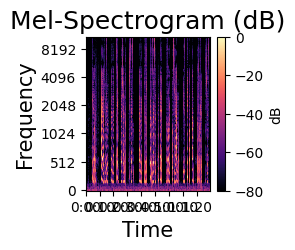

audio degraded_test_sg


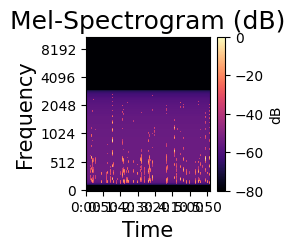

In [43]:

print ("audio reconstructed_test")
IPython.display.display(IPython.display.Audio(reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))

print ("audio degraded_test_sg")
IPython.display.display(IPython.display.Audio(reconstructed_degraded_test,  rate=sr))
pp.plot_mel_spectrogram(degraded_train_sg,sr, figsize=(2,2))


### model - pix2pix


In [48]:
import tensorflow as tf
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [49]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [55]:
inp_long = degraded_train_sg

In [59]:
re_long = train_sg

In [60]:
print (f"inp_long.shape = {inp_long.shape}, re_long.shape = {re_long.shape}")

inp_long.shape = (256, 15381), re_long.shape = (256, 15381)


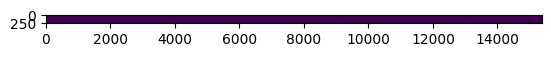

In [62]:
from matplotlib import pyplot as plt

plt.figure()
plt.imshow(inp_long / 255.0)


inp.shape = (256, 255), re.shape = (256, 255)


/tmp/ipykernel_491274/4143817559.py:1: RuntimeWarning: divide by zero encountered in log
  inp = np.log(inp_long[:, 0:255]) # inp_long[:, 0:255]


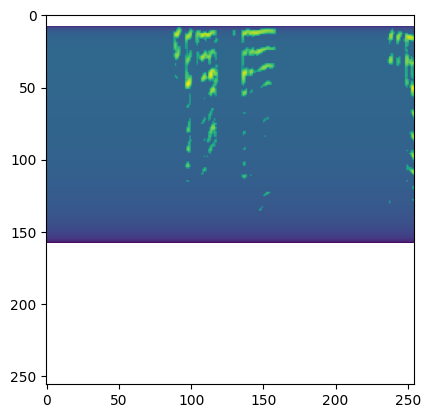

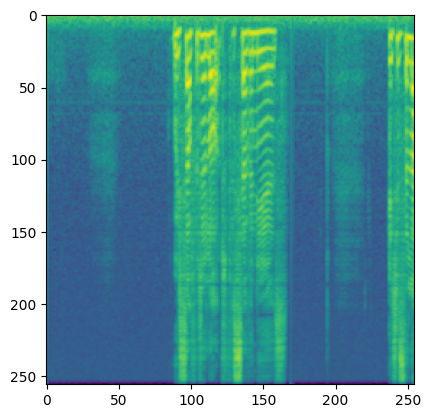

In [66]:
inp = np.log(inp_long[:, 0:255]) # inp_long[:, 0:255]
re = np.log(re_long[:, 0:255])
print (f"inp.shape = {inp.shape}, re.shape = {re.shape}")
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [50]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

NameError: name 'inp' is not defined

### model - simple autoencoder

let us start with the simplest possible model - restoring 1 column of MEL spectrogram (256 entries)
this loses out on the previous time snapshots, but should be simple to train
Accordingly, instead of Conv2d, we will have Conv1d

In [68]:
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
#from tensorflow.keras.layers import Conv2D, Conv1D, MaxPooling2D, Flatten, Dense
#from tensorflow.keras.layers import MaxPooling1D



In [ ]:

def build_encoder():
    '''returns an encoder model, of output_shape equals to latent_dimension'''
    encoder = models.Sequential()
    encoder.add(layers.Dense(100, input_dim=256, activation='tanh'))

    return encoder


In [ ]:
encoder = build_encoder()
encoder.summary()

In [ ]:

def build_decoder():
    decoder = models.Sequential()

    decoder.add(layers.Dense(256, input_dim=100, activation='relu'))

    return decoder


In [ ]:
decoder = build_decoder()
decoder.summary()

In [70]:
from tensorflow.keras.optimizers import Adam

autoencoder = models.Sequential([encoder, decoder])
#autoencoder.compile(loss="mse", optimizer=Adam(learning_rate=0.1))
optimizer = Adam()

autoencoder.compile(loss='mse',
                  optimizer=optimizer,
                  metrics=['mse'])


NameError: name 'encoder' is not defined

In [ ]:
autoencoder.summary()

In [ ]:
train_sg_t =  np.transpose(train_sg)

In [ ]:
degraded_train_sg_t =  np.transpose(degraded_train_sg)

### train the model

In [76]:
import tensorflow as tf
def reinitialize(model):
    for l in model.layers:
        if isinstance(l, tf.keras.Model):
            reinitialize(l)
            continue
        if hasattr(l,"kernel_initializer"):
            l.kernel.assign(l.kernel_initializer(tf.shape(l.kernel)))
        if hasattr(l,"bias_initializer"):
            l.bias.assign(l.bias_initializer(tf.shape(l.bias)))
        if hasattr(l,"recurrent_initializer"):
            l.recurrent_kernel.assign(l.recurrent_initializer(tf.shape(l.recurrent_kernel)))

In [ ]:
reinitialize(autoencoder)

In [ ]:


history = autoencoder.fit(train_sg_t, train_sg_t ,
                           validation_split = 0.2,
                           epochs=100,
                           batch_size=32,
                           workers=3,
                           use_multiprocessing=True,
                           verbose=1)

In [ ]:
hist_df = pd.DataFrame(history.history)

headers = list(hist_df.columns.values)


plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)
#plot = hist_df[[headers[1], headers[3]]].plot(title=f"{headers[1]}, {headers[3]}", logy=False)

### save the model

In [ ]:
models.save_model(autoencoder, 'autoencoder_001a')


### how does the model sound?

In [ ]:
restored_test_sg_t = autoencoder.predict(np.transpose(degraded_test_sg))

In [ ]:
reconstructed_restored_test = pp.spectrogram_2_waveform (np.transpose(restored_test_sg_t), sr=sr)

In [ ]:
print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_restored_test,  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

# even simpler (10, 256) model training


In [71]:
### simper model
from tensorflow.keras.optimizers import Adam

def build_the_simplest_model_possible():
    simplest_model = models.Sequential()
    simplest_model.add(layers.Dense(10, input_dim=256, activation='relu'))
    simplest_model.add(layers.Dense(256, input_dim=100, activation='relu'))
    return simplest_model
simplest_model = build_the_simplest_model_possible()
optimizer = Adam()

simplest_model.compile(loss='mse',
                  optimizer=optimizer,
                  metrics=['mse'])


In [72]:
# Cache to RAM to speed up the training. This requires arrays to be converted to Datasets
from tensorflow import data
#from tensorflow.data.Dataset import cache



train_dataset = data.Dataset.from_tensor_slices((np.transpose(train_sg), np.transpose(train_sg))).batch(10000)
validation_dataset = data.Dataset.from_tensor_slices((np.transpose(test_sg), np.transpose(test_sg))).batch(3000)


AUTOTUNE = data.experimental.AUTOTUNE
train_dataset = train_dataset.cache().prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.cache().prefetch(buffer_size=AUTOTUNE)

#val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [74]:
print (f"train_sg.shape={train_sg.shape}")
print (f"test_sg.shape={test_sg.shape}")

train_sg.shape=(256, 15381)
test_sg.shape=(256, 3845)


In [81]:
from tensorflow.keras import callbacks
from keras.callbacks import EarlyStopping
from keras.callbacks import BackupAndRestore


es = EarlyStopping(
    monitor="val_loss",
    patience=10,
    restore_best_weights=True,
    verbose=0
)

br = BackupAndRestore(
    backup_dir="training_backup",
    save_freq="epoch",
    delete_checkpoint=True
)
reinitialize(simplest_model)
history = simplest_model.fit( x=train_dataset,
                           batch_size=4,
                           validation_data=validation_dataset,
                           epochs=500,
                           verbose=1,
                           workers=24,
                           callbacks=[es,br],
                           use_multiprocessing=True)

Epoch 1/500
2/2 [==============================] - 0s 60ms/step - loss: 588.6414 - mse: 588.6414 - val_loss: 498.9867 - val_mse: 498.9867
Epoch 2/500
2/2 [==============================] - 0s 50ms/step - loss: 586.4504 - mse: 586.4504 - val_loss: 495.7670 - val_mse: 495.7670
Epoch 3/500
2/2 [==============================] - 0s 43ms/step - loss: 582.8201 - mse: 582.8201 - val_loss: 492.0482 - val_mse: 492.0482
Epoch 4/500
2/2 [==============================] - 0s 58ms/step - loss: 578.8144 - mse: 578.8144 - val_loss: 488.4801 - val_mse: 488.4801
Epoch 5/500
2/2 [==============================] - 0s 46ms/step - loss: 575.0231 - mse: 575.0231 - val_loss: 485.2432 - val_mse: 485.2432
Epoch 6/500
2/2 [==============================] - 0s 51ms/step - loss: 571.5856 - mse: 571.5856 - val_loss: 482.3128 - val_mse: 482.3128
Epoch 7/500
2/2 [==============================] - 0s 43ms/step - loss: 568.4401 - mse: 568.4401 - val_loss: 479.5782 - val_mse: 479.5782
Epoch 8/500
2/2 [=================

In [81]:
from tensorflow.keras import callbacks
from keras.callbacks import EarlyStopping
from keras.callbacks import BackupAndRestore


es = EarlyStopping(
    monitor="val_loss",
    patience=10,
    restore_best_weights=True,
    verbose=0
)

br = BackupAndRestore(
    backup_dir="training_backup",
    save_freq="epoch",
    delete_checkpoint=True
)
reinitialize(simplest_model)
history = simplest_model.fit( x=train_dataset,
                           batch_size=4,
                           validation_data=validation_dataset,
                           epochs=500,
                           verbose=1,
                           workers=24,
                           callbacks=[es,br],
                           use_multiprocessing=True)

Epoch 1/500
2/2 [==============================] - 0s 60ms/step - loss: 588.6414 - mse: 588.6414 - val_loss: 498.9867 - val_mse: 498.9867
Epoch 2/500
2/2 [==============================] - 0s 50ms/step - loss: 586.4504 - mse: 586.4504 - val_loss: 495.7670 - val_mse: 495.7670
Epoch 3/500
2/2 [==============================] - 0s 43ms/step - loss: 582.8201 - mse: 582.8201 - val_loss: 492.0482 - val_mse: 492.0482
Epoch 4/500
2/2 [==============================] - 0s 58ms/step - loss: 578.8144 - mse: 578.8144 - val_loss: 488.4801 - val_mse: 488.4801
Epoch 5/500
2/2 [==============================] - 0s 46ms/step - loss: 575.0231 - mse: 575.0231 - val_loss: 485.2432 - val_mse: 485.2432
Epoch 6/500
2/2 [==============================] - 0s 51ms/step - loss: 571.5856 - mse: 571.5856 - val_loss: 482.3128 - val_mse: 482.3128
Epoch 7/500
2/2 [==============================] - 0s 43ms/step - loss: 568.4401 - mse: 568.4401 - val_loss: 479.5782 - val_mse: 479.5782
Epoch 8/500
2/2 [=================

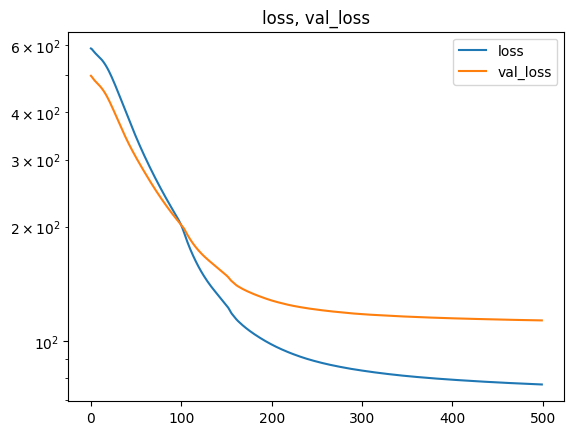

In [82]:
hist_df = pd.DataFrame(history.history)
headers = list(hist_df.columns.values)
plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)

INFO:tensorflow:Assets written to: autoencoder_baseline_10-256-trained-on-good/assets


INFO:tensorflow:Assets written to: autoencoder_baseline_10-256-trained-on-good/assets


121/121 [==============================] - 0s 1ms/step
reconstructed_test


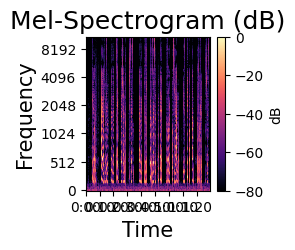

reconstructed_restored_degraded_test


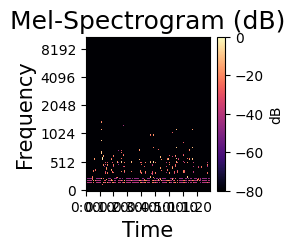

In [85]:
models.save_model(simplest_model, 'autoencoder_baseline_10-256-trained-on-good')

restored_test_sg_t = simplest_model.predict(np.transpose(degraded_test_sg))

print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=pp.spectrogram_2_waveform(np.transpose(restored_test_sg_t), sr=sr),  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

## preprocessing  - add log on the input to the model to reduce the variance of features

In [88]:
train_df=pd.DataFrame(np.transpose(train_sg))


In [89]:
train_df.describe()

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
count,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,15381.000000,...,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04,1.538100e+04
mean,0.323083,0.272572,0.090251,0.065324,0.060335,0.036475,0.022967,0.014637,0.019104,0.171743,...,3.830091e-03,4.773456e-03,6.070160e-03,7.833500e-03,9.325371e-03,9.960023e-03,5.417584e-03,1.434385e-03,1.251531e-04,1.315460e-06
std,0.365999,0.363743,0.143089,0.107276,0.136751,0.114983,0.085700,0.058581,0.077714,1.021386,...,3.353030e-02,4.485044e-02,7.135128e-02,8.066172e-02,7.295736e-02,8.208285e-02,4.565805e-02,1.121445e-02,1.070261e-03,9.624826e-06
min,0.000847,0.000570,0.000357,0.000268,0.000447,0.000011,0.000036,0.000011,0.000012,0.000010,...,3.599596e-08,2.567064e-08,3.234273e-08,3.051958e-08,3.899831e-08,3.047284e-08,2.242024e-08,5.622780e-09,4.785821e-10,4.706663e-12
25%,0.095916,0.083876,0.032194,0.020837,0.016516,0.005777,0.002401,0.001247,0.000991,0.000683,...,1.614855e-07,1.626544e-07,1.657398e-07,1.709385e-07,1.767345e-07,1.648197e-07,1.082063e-07,3.220841e-08,2.713620e-09,3.513100e-11
50%,0.215271,0.176594,0.060126,0.042744,0.033565,0.012898,0.005085,0.002676,0.002345,0.002331,...,3.671027e-06,3.464114e-06,3.326609e-06,4.203085e-06,5.678860e-06,5.863565e-06,3.513050e-06,9.689935e-07,8.553114e-08,1.264325e-09
75%,0.429146,0.342866,0.107400,0.081572,0.065919,0.027349,0.011335,0.006346,0.007511,0.032080,...,6.788530e-05,6.246676e-05,6.671256e-05,9.458826e-05,1.467603e-04,1.628881e-04,1.017078e-04,2.998652e-05,2.755828e-06,3.403947e-08
max,7.684287,11.485275,6.498601,7.425876,8.971133,5.103196,2.238372,2.177324,2.325310,27.561529,...,1.794322e+00,2.990064e+00,4.402164e+00,4.936981e+00,2.098149e+00,3.384795e+00,2.108838e+00,3.541920e-01,6.466301e-02,3.310965e-04


In [91]:
#inp = np.log(inp_long[:, 0:255]) # inp_long[:, 0:255]
#note - adding 0.00000001 to all entries to prevent log(0)
log_train_dataset = data.Dataset.from_tensor_slices(
    (
        np.log(
            0.00000001 + np.transpose(
                train_sg
            )
        ), 
        np.log(
            0.00000001 + np.transpose(
                train_sg
            )
        )
    )
).batch(10000)
log_validation_dataset = data.Dataset.from_tensor_slices(
    (
        np.log(
            0.00000001 + np.transpose(
                test_sg
            )
        ), 
        np.log(
            0.00000001 + np.transpose(
                test_sg
            )
        )
    )
).batch(3000)


In [92]:
AUTOTUNE = data.experimental.AUTOTUNE
log_train_dataset = log_train_dataset.cache().prefetch(buffer_size=AUTOTUNE)
log_validation_dataset = log_validation_dataset.cache().prefetch(buffer_size=AUTOTUNE)

In [94]:
simplest_model_on_log = build_the_simplest_model_possible()
optimizer = Adam()

simplest_model_on_log.compile(loss='mse',
                  optimizer=optimizer,
                  metrics=['mse'])


In [95]:
from tensorflow.keras import callbacks
from keras.callbacks import EarlyStopping
from keras.callbacks import BackupAndRestore


es = EarlyStopping(
    monitor="val_loss",
    patience=10,
    restore_best_weights=True,
    verbose=0
)

br = BackupAndRestore(
    backup_dir="training_backup",
    save_freq="epoch",
    delete_checkpoint=True
)
reinitialize(simplest_model_on_log)
history = simplest_model_on_log.fit( x=log_train_dataset,
                           batch_size=4,
                           validation_data=log_validation_dataset,
                           epochs=500,
                           verbose=1,
                           workers=24,
                           callbacks=[es,br],
                           use_multiprocessing=True)

Epoch 1/500
2/2 [==============================] - 1s 116ms/step - loss: 127.2299 - mse: 127.2299 - val_loss: 118.6582 - val_mse: 118.6582
Epoch 2/500
2/2 [==============================] - 0s 52ms/step - loss: 120.7245 - mse: 120.7245 - val_loss: 114.1495 - val_mse: 114.1495
Epoch 3/500
2/2 [==============================] - 0s 47ms/step - loss: 116.2652 - mse: 116.2652 - val_loss: 110.5413 - val_mse: 110.5413
Epoch 4/500
2/2 [==============================] - 0s 45ms/step - loss: 112.6855 - mse: 112.6855 - val_loss: 107.4470 - val_mse: 107.4470
Epoch 5/500
2/2 [==============================] - 0s 50ms/step - loss: 109.5985 - mse: 109.5985 - val_loss: 105.0486 - val_mse: 105.0486
Epoch 6/500
2/2 [==============================] - 0s 50ms/step - loss: 107.4581 - mse: 107.4581 - val_loss: 104.6506 - val_mse: 104.6506
Epoch 7/500
2/2 [==============================] - 0s 44ms/step - loss: 107.1048 - mse: 107.1048 - val_loss: 104.5033 - val_mse: 104.5033
Epoch 8/500
2/2 [================

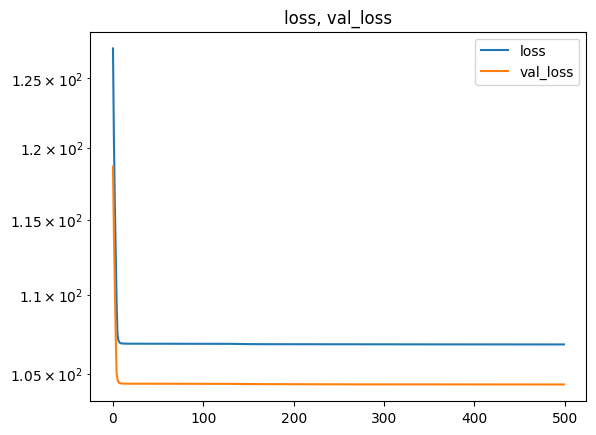

In [96]:
hist_df = pd.DataFrame(history.history)
headers = list(hist_df.columns.values)
plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)

In [ ]:
#models.save_model(simplest_model, 'autoencoder_baseline_10-256-trained-on-good')

restored_test_sg_t = simplest_model_on_log.predict(mp.log(0.00000001 + np.transpose(degraded_test_sg)))

print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=pp.spectrogram_2_waveform(np.transpose(restored_test_sg_t), sr=sr),  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

# how about training the simpler model on degraded rather than perfect audio?

In [ ]:
# Cache to RAM to speed up the training. This requires arrays to be converted to Datasets
from tensorflow import data
#from tensorflow.data.Dataset import cache

train_dataset = data.Dataset.from_tensor_slices((np.transpose(degraded_train_sg), np.transpose(train_sg))).batch(10000)
validation_dataset = data.Dataset.from_tensor_slices((np.transpose(degraded_test_sg), np.transpose(test_sg))).batch(3000)


AUTOTUNE = data.experimental.AUTOTUNE
train_dataset = train_dataset.cache().prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.cache().prefetch(buffer_size=AUTOTUNE)

#val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
es = EarlyStopping(
    monitor="val_loss",
    patience=10,
    restore_best_weights=True,
    verbose=0
)

br = BackupAndRestore(
    backup_dir="training_backup",
    save_freq="epoch",
    delete_checkpoint=True
)

history = simplest_model.fit( x=train_dataset,
                           batch_size=4,
                           validation_data=validation_dataset,
                           epochs=1000,
                           verbose=1,
                           workers=24,
                           callbacks=[es,br],
                           use_multiprocessing=True)

In [ ]:
hist_df = pd.DataFrame(history.history)
headers = list(hist_df.columns.values)
plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)

In [ ]:
models.save_model(simplest_model, 'autoencoder_baseline_10-256-trained-on_degraded')

restored_test_sg_t = simplest_model.predict(np.transpose(degraded_test_sg))

print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_restored_test,  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

# try convolutional autoencoder


In [ ]:
def build_convolutional_autoencoder():
    conv_ac = models.Sequential()
    conv_ac.add(layers.Reshape([256,1], input_shape=[256]))
    conv_ac.add(layers.Conv1D(16, kernel_size=6, padding="same", input_dim=[256,1], activation='selu'))
    conv_ac.add(layers.MaxPool1D(pool_size=4))
    conv_ac.add(layers.Conv1D(32, kernel_size=6, padding="same", activation='selu'))
    conv_ac.add(layers.MaxPool1D(pool_size=4))
    conv_ac.add(layers.Conv1D(64, kernel_size=6, padding="same", activation='selu'))
    conv_ac.add(layers.MaxPool1D(pool_size=4))

    conv_ac.add(layers.Conv1DTranspose(32, kernel_size=6, strides=4, padding="same", activation='selu'))
    conv_ac.add(layers.Conv1DTranspose(16, kernel_size=6, strides=4, padding="same", activation='selu'))
    conv_ac.add(layers.Conv1DTranspose(1, kernel_size=6, strides=4, padding="same", activation='relu'))


    return conv_ac
conv_ac = build_convolutional_autoencoder()
optimizer = Adam()

conv_ac.compile(loss='mse',
                  optimizer=optimizer,
                  metrics=['mse'])

In [ ]:
conv_ac.summary()

In [ ]:
# Cache to RAM to speed up the training. This requires arrays to be converted to Datasets
from tensorflow import data
#from tensorflow.data.Dataset import cache

train_dataset = data.Dataset.from_tensor_slices((np.transpose(degraded_train_sg), np.transpose(train_sg))).batch(10000)
validation_dataset = data.Dataset.from_tensor_slices((np.transpose(degraded_test_sg), np.transpose(test_sg))).batch(3000)


AUTOTUNE = data.experimental.AUTOTUNE
train_dataset = train_dataset.cache().prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.cache().prefetch(buffer_size=AUTOTUNE)

#val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
es = EarlyStopping(
    monitor="val_loss",
    patience=10,
    restore_best_weights=True,
    verbose=0
)

br = BackupAndRestore(
    backup_dir="training_backup",
    save_freq="epoch",
    delete_checkpoint=True
)

history = conv_ac.fit( x=train_dataset,
                           batch_size=4,
                           validation_data=validation_dataset,
                           epochs=100,
                           verbose=1,
                           workers=24,
                           callbacks=[es,br],
                           use_multiprocessing=True)

In [ ]:
hist_df = pd.DataFrame(history.history)
headers = list(hist_df.columns.values)
plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)

In [ ]:
restored_test_sg_t = conv_ac.predict(np.transpose(degraded_test_sg))


In [ ]:
restored_test_sg_t.shape

In [ ]:
reconstructed_test.shape

In [ ]:
models.save_model(conv_ac, 'conv_16-32-64-32-16-1')

restored_test_sg_t = conv_ac.predict(np.transpose(degraded_test_sg))[:, :, 0]

print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=np.transpose(restored_test_sg_t),  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

# Simple autoencoder (100, 256 dense) model training


In [ ]:
reinitialize(autoencoder)

In [ ]:
history = autoencoder.fit( x=train_dataset,
                           batch_size=4,
                           validation_data=validation_dataset,
                           epochs=10000,
                           verbose=1,
                           workers=24,
                           use_multiprocessing=True)

In [ ]:
hist_df = pd.DataFrame(history.history)
headers = list(hist_df.columns.values)
plot = hist_df[[headers[0], headers[2]]].plot(title=f"{headers[0]}, {headers[2]}", logy=True)

In [ ]:
models.save_model(autoencoder, 'autoencoder_baseline_10000')

In [ ]:
restored_test_sg_t = autoencoder.predict(np.transpose(degraded_test_sg))

In [ ]:
print ("reconstructed_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_test,  rate=sr))
pp.plot_mel_spectrogram(test_sg,sr, figsize=(2,2))


print ("reconstructed_restored_degraded_test")
IPython.display.display(IPython.display.Audio(data=reconstructed_restored_test,  rate=sr))
pp.plot_mel_spectrogram(np.transpose(restored_test_sg_t),sr, figsize=(2,2))

In [ ]:
from tensorflow.keras import callbacks
from keras.callbacks import EarlyStopping
from keras.callbacks import BackupAndRestore



## same  model with reg

## same  model with dropout

## same  model with dropout & reg

In [ ]:
models.save_model(autoencoder_do_reg, 'autoencoder_002')

In [ ]:
models.save_model(autoencoder_do_reg_selu, 'autoencoder_003')